## Introduction

Time series forecasting has been one of the main aspects that got me interested in data and i finally wanted to try it out for myself and see if i can create a SARIMA model.

In this notebook i will be looking at power demand time series data collected from different appliances in a seven-story academic office building located at Chulalongkorn University. The building has an area of around 11,700 square meters.

## My goals 

- Explore the data from different aspects
- Understand Clustering and Dendrograms
- Use a SARIMA model to predict the daily power demand of the entire building



In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()
from sklearn.cluster import KMeans
from sklearn import preprocessing

%matplotlib inline

from datetime import datetime
from datetime import timedelta
from datetime import date

from plotly import __version__
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import cufflinks as cf
init_notebook_mode(connected=True)
cf.go_offline()
import plotly.express as px
import chart_studio.plotly as py

pd.set_option('display.max_columns', None)

In [2]:
raw_data = pd.read_csv('Data/raw_data', index_col='Date')
raw_data.index = pd.to_datetime(raw_data.index, errors='coerce')
raw_data.head()

,Floor1_z1_Light(kW),Floor1_z1_Plug(kW),Floor1_z2_AC1(kW),Floor1_z2_AC2(kW),Floor1_z2_AC3(kW),Floor1_z2_AC4(kW),Floor1_z2_Light(kW),Floor1_z2_Plug(kW),Floor1_z3_Light(kW),Floor1_z3_Plug(kW),Floor1_z4_Light(kW),Floor2_z1_AC1(kW),Floor2_z1_Light(kW),Floor2_z1_Plug(kW),Floor2_z1_S1(degC),Floor2_z1_S1(RH%),Floor2_z1_S1(lux),Floor2_z2_AC1(kW),Floor2_z2_AC2(kW),Floor2_z2_AC3(kW),Floor2_z2_AC4(kW),Floor2_z2_AC5(kW),Floor2_z2_AC6(kW),Floor2_z2_AC7(kW),Floor2_z2_AC8(kW),Floor2_z2_AC9(kW),Floor2_z2_AC10(kW),Floor2_z2_AC11(kW),Floor2_z2_AC12(kW),Floor2_z2_AC13(kW),Floor2_z2_AC14(kW),Floor2_z2_Light(kW),Floor2_z2_Plug(kW),Floor2_z2_S1(degC),Floor2_z2_S1(RH%),Floor2_z2_S1(lux),Floor2_z3_Light(kW),Floor2_z3_Plug(kW),Floor2_z3_S1(degC),Floor2_z3_S1(RH%),Floor2_z3_S1(lux),Floor2_z4_AC1(kW),Floor2_z4_Light(kW),Floor2_z4_Plug(kW),Floor2_z4_S1(degC),Floor2_z4_S1(RH%),Floor2_z4_S1(lux),Floor3_z1_AC1(kW),Floor3_z1_AC2(kW),Floor3_z1_AC3(kW),Floor3_z1_AC4(kW),Floor3_z1_Light(kW),Floor3_z1_Plug(kW),Floor3_z1_S1(degC),Floor3_z1_S1(RH%),Floor3_z1_S1(lux),Floor3_z2_AC1(kW),Floor3_z2_Light(kW),Floor3_z2_Plug(kW),Floor3_z2_S1(degC),Floor3_z2_S1(RH%),Floor3_z2_S1(lux),Floor3_z3_Light(kW),Floor3_z3_Plug(kW),Floor3_z4_AC1(kW),Floor3_z4_Light(kW),Floor3_z4_Plug(kW),Floor3_z4_S1(degC),Floor3_z4_S1(RH%),Floor3_z4_S1(lux),Floor3_z5_AC1(kW),Floor3_z5_Light(kW),Floor3_z5_Plug(kW),Floor3_z5_S1(degC),Floor3_z5_S1(RH%),Floor3_z5_S1(lux),Floor4_z1_AC1(kW),Floor4_z1_AC2(kW),Floor4_z1_AC3(kW),Floor4_z1_AC4(kW),Floor4_z1_Light(kW),Floor4_z1_Plug(kW),Floor4_z1_S1(degC),Floor4_z1_S1(RH%),Floor4_z1_S1(lux),Floor4_z2_AC1(kW),Floor4_z2_Light(kW),Floor4_z2_Plug(kW),Floor4_z2_S1(degC),Floor4_z2_S1(RH%),Floor4_z2_S1(lux),Floor4_z3_Light(kW),Floor4_z3_Plug(kW),Floor4_z4_AC1(kW),Floor4_z4_Light(kW),Floor4_z4_Plug(kW),Floor4_z4_S1(degC),Floor4_z4_S1(RH%),Floor4_z4_S1(lux),Floor4_z5_AC1(kW),Floor4_z5_Light(kW),Floor4_z5_Plug(kW),Floor4_z5_S1(degC),Floor4_z5_S1(RH%),Floor4_z5_S1(lux),Floor5_z1_AC1(kW),Floor5_z1_AC2(kW),Floor5_z1_AC3(kW),Floor5_z1_AC4(kW),Floor5_z1_Light(kW),Floor5_z1_Plug(kW),Floor5_z1_S1(degC),Floor5_z1_S1(RH%),Floor5_z1_S1(lux),Floor5_z2_AC1(kW),Floor5_z2_Light(kW),Floor5_z2_Plug(kW),Floor5_z2_S1(degC),Floor5_z2_S1(RH%),Floor5_z2_S1(lux),Floor5_z3_Light(kW),Floor5_z3_Plug(kW),Floor5_z4_AC1(kW),Floor5_z4_Light(kW),Floor5_z4_Plug(kW),Floor5_z4_S1(degC),Floor5_z4_S1(RH%),Floor5_z4_S1(lux),Floor5_z5_AC1(kW),Floor5_z5_Light(kW),Floor5_z5_Plug(kW),Floor5_z5_S1(degC),Floor5_z5_S1(RH%),Floor5_z5_S1(lux),Floor6_z1_AC1(kW),Floor6_z1_Light(kW),Floor6_z1_Plug(kW),Floor6_z1_S1(degC),Floor6_z1_S1(RH%),Floor6_z1_S1(lux),Floor6_z2_AC1(kW),Floor6_z2_Light(kW),Floor6_z2_Plug(kW),Floor6_z2_S1(degC),Floor6_z2_S1(RH%),Floor6_z2_S1(lux),Floor6_z3_Light(kW),Floor6_z3_Plug(kW),Floor6_z4_AC1(kW),Floor6_z4_AC2(kW),Floor6_z4_AC3(kW),Floor6_z4_AC4(kW),Floor6_z4_Light(kW),Floor6_z4_Plug(kW),Floor6_z4_S1(degC),Floor6_z4_S1(RH%),Floor6_z4_S1(lux),Floor6_z5_AC1(kW),Floor6_z5_Light(kW),Floor6_z5_Plug(kW),Floor6_z5_S1(degC),Floor6_z5_S1(RH%),Floor6_z5_S1(lux),Floor7_z1_AC1(kW),Floor7_z1_AC2(kW),Floor7_z1_AC3(kW),Floor7_z1_AC4(kW),Floor7_z1_Light(kW),Floor7_z1_Plug(kW),Floor7_z1_S1(degC),Floor7_z1_S1(RH%),Floor7_z1_S1(lux),Floor7_z2_AC1(kW),Floor7_z2_Light(kW),Floor7_z2_Plug(kW),Floor7_z2_S1(degC),Floor7_z2_S1(RH%),Floor7_z2_S1(lux),Floor7_z3_Light(kW),Floor7_z3_Plug(kW),Floor7_z4_AC1(kW),Floor7_z4_Light(kW),Floor7_z4_Plug(kW),Floor7_z4_S1(degC),Floor7_z4_S1(RH%),Floor7_z4_S1(lux),Floor7_z5_AC1(kW),Floor7_z5_Light(kW),Floor7_z5_Plug(kW),Floor7_z5_S1(degC),Floor7_z5_S1(RH%),Floor7_z5_S1(lux)
Date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2018-07-01 00:00:00,12.94,18.56,45.24,0.01,0.01,0.00,13.76,17.64,10.92,0.89,35.76,0.0,0.01,0.15,28.36,58.93,0.0,1.08,0.0,0.0,0.0,1.29,1.26,0.87,0.92,0.96,1.07,0.0,0.0,0.0,0.0,0.0,0.10,28.85,64.89,0.0,0.01,0.32,29.30,68.

In [3]:
raw_data.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 790561 entries, 2018-07-01 00:00:00 to 2019-12-31 23:59:00
Columns: 192 entries, Floor1_z1_Light(kW) to Floor7_z5_S1(lux)
dtypes: float64(192)
memory usage: 1.1 GB


In [4]:
raw_data.describe()

,Floor1_z1_Light(kW),Floor1_z1_Plug(kW),Floor1_z2_AC1(kW),Floor1_z2_AC2(kW),Floor1_z2_AC3(kW),Floor1_z2_AC4(kW),Floor1_z2_Light(kW),Floor1_z2_Plug(kW),Floor1_z3_Light(kW),Floor1_z3_Plug(kW),Floor1_z4_Light(kW),Floor2_z1_AC1(kW),Floor2_z1_Light(kW),Floor2_z1_Plug(kW),Floor2_z1_S1(degC),Floor2_z1_S1(RH%),Floor2_z1_S1(lux),Floor2_z2_AC1(kW),Floor2_z2_AC2(kW),Floor2_z2_AC3(kW),Floor2_z2_AC4(kW),Floor2_z2_AC5(kW),Floor2_z2_AC6(kW),Floor2_z2_AC7(kW),Floor2_z2_AC8(kW),Floor2_z2_AC9(kW),Floor2_z2_AC10(kW),Floor2_z2_AC11(kW),Floor2_z2_AC12(kW),Floor2_z2_AC13(kW),Floor2_z2_AC14(kW),Floor2_z2_Light(kW),Floor2_z2_Plug(kW),Floor2_z2_S1(degC),Floor2_z2_S1(RH%),Floor2_z2_S1(lux),Floor2_z3_Light(kW),Floor2_z3_Plug(kW),Floor2_z3_S1(degC),Floor2_z3_S1(RH%),Floor2_z3_S1(lux),Floor2_z4_AC1(kW),Floor2_z4_Light(kW),Floor2_z4_Plug(kW),Floor2_z4_S1(degC),Floor2_z4_S1(RH%),Floor2_z4_S1(lux),Floor3_z1_AC1(kW),Floor3_z1_AC2(kW),Floor3_z1_AC3(kW),Floor3_z1_AC4(kW),Floor3_z1_Light(kW),Floor3_z1_Plug(kW),Floor3_z1_S1(degC),Floor3_z1_S1(RH%),Floor3_z1_S1(lux),Floor3_z2_AC1(kW),Floor3_z2_Light(kW),Floor3_z2_Plug(kW),Floor3_z2_S1(degC),Floor3_z2_S1(RH%),Floor3_z2_S1(lux),Floor3_z3_Light(kW),Floor3_z3_Plug(kW),Floor3_z4_AC1(kW),Floor3_z4_Light(kW),Floor3_z4_Plug(kW),Floor3_z4_S1(degC),Floor3_z4_S1(RH%),Floor3_z4_S1(lux),Floor3_z5_AC1(kW),Floor3_z5_Light(kW),Floor3_z5_Plug(kW),Floor3_z5_S1(degC),Floor3_z5_S1(RH%),Floor3_z5_S1(lux),Floor4_z1_AC1(kW),Floor4_z1_AC2(kW),Floor4_z1_AC3(kW),Floor4_z1_AC4(kW),Floor4_z1_Light(kW),Floor4_z1_Plug(kW),Floor4_z1_S1(degC),Floor4_z1_S1(RH%),Floor4_z1_S1(lux),Floor4_z2_AC1(kW),Floor4_z2_Light(kW),Floor4_z2_Plug(kW),Floor4_z2_S1(degC),Floor4_z2_S1(RH%),Floor4_z2_S1(lux),Floor4_z3_Light(kW),Floor4_z3_Plug(kW),Floor4_z4_AC1(kW),Floor4_z4_Light(kW),Floor4_z4_Plug(kW),Floor4_z4_S1(degC),Floor4_z4_S1(RH%),Floor4_z4_S1(lux),Floor4_z5_AC1(kW),Floor4_z5_Light(kW),Floor4_z5_Plug(kW),Floor4_z5_S1(degC),Floor4_z5_S1(RH%),Floor4_z5_S1(lux),Floor5_z1_AC1(kW),Floor5_z1_AC2(kW),Floor5_z1_AC3(kW),Floor5_z1_AC4(kW),Floor5_z1_Light(kW),Floor5_z1_Plug(kW),Floor5_z1_S1(degC),Floor5_z1_S1(RH%),Floor5_z1_S1(lux),Floor5_z2_AC1(kW),Floor5_z2_Light(kW),Floor5_z2_Plug(kW),Floor5_z2_S1(degC),Floor5_z2_S1(RH%),Floor5_z2_S1(lux),Floor5_z3_Light(kW),Floor5_z3_Plug(kW),Floor5_z4_AC1(kW),Floor5_z4_Light(kW),Floor5_z4_Plug(kW),Floor5_z4_S1(degC),Floor5_z4_S1(RH%),Floor5_z4_S1(lux),Floor5_z5_AC1(kW),Floor5_z5_Light(kW),Floor5_z5_Plug(kW),Floor5_z5_S1(degC),Floor5_z5_S1(RH%),Floor5_z5_S1(lux),Floor6_z1_AC1(kW),Floor6_z1_Light(kW),Floor6_z1_Plug(kW),Floor6_z1_S1(degC),Floor6_z1_S1(RH%),Floor6_z1_S1(lux),Floor6_z2_AC1(kW),Floor6_z2_Light(kW),Floor6_z2_Plug(kW),Floor6_z2_S1(degC),Floor6_z2_S1(RH%),Floor6_z2_S1(lux),Floor6_z3_Light(kW),Floor6_z3_Plug(kW),Floor6_z4_AC1(kW),Floor6_z4_AC2(kW),Floor6_z4_AC3(kW),Floor6_z4_AC4(kW),Floor6_z4_Light(kW),Floor6_z4_Plug(kW),Floor6_z4_S1(degC),Floor6_z4_S1(RH%),Floor6_z4_S1(lux),Floor6_z5_AC1(kW),Floor6_z5_Light(kW),Floor6_z5_Plug(kW),Floor6_z5_S1(degC),Floor6_z5_S1(RH%),Floor6_z5_S1(lux),Floor7_z1_AC1(kW),Floor7_z1_AC2(kW),Floor7_z1_AC3(kW),Floor7_z1_AC4(kW),Floor7_z1_Light(kW),Floor7_z1_Plug(kW),Floor7_z1_S1(degC),Floor7_z1_S1(RH%),Floor7_z1_S1(lux),Floor7_z2_AC1(kW),Floor7_z2_Light(kW),Floor7_z2_Plug(kW),Floor7_z2_S1(degC),Floor7_z2_S1(RH%),Floor7_z2_S1(lux),Floor7_z3_Light(kW),Floor7_z3_Plug(kW),Floor7_z4_AC1(kW),Floor7_z4_Light(kW),Floor7_z4_Plug(kW),Floor7_z4_S1(degC),Floor7_z4_S1(RH%),Floor7_z4_S1(lux),Floor7_z5_AC1(kW),Floor7_z5_Light(kW),Floor7_z5_Plug(kW),Floor7_z5_S1(degC),Floor7_z5_S1(RH%),Floor7_z5_S1(lux)
count,788169.000000,789459.000000,788231.000000,788355.000000,788354.000000,788354.000000,788516.000000,760031.000000,789447.000000,788355.000000,789433.000000,760318.000000,789492.000000,789487.000000,515922.000000,515922.000000,515922.000000,760084.000000,787961.000000,787961.000000,787961.000000,789417.000000,789417.000000,789417.000000,789417.000000,789417.000000,789417.000000,789417.0,789417.000000,789417.00

## Data Preprocessing

In this step, i will try to restructure the data so it can be used in multiple different ways, depending on what information we're interested in.(exp. power demand per floor, year, appliance, etc.)

I will start by only looking at columns that contain kW information.

In [5]:
kw_df = raw_data.loc[:, raw_data.columns.str.contains('kW')]

In [6]:
kw_df.head()

,Floor1_z1_Light(kW),Floor1_z1_Plug(kW),Floor1_z2_AC1(kW),Floor1_z2_AC2(kW),Floor1_z2_AC3(kW),Floor1_z2_AC4(kW),Floor1_z2_Light(kW),Floor1_z2_Plug(kW),Floor1_z3_Light(kW),Floor1_z3_Plug(kW),Floor1_z4_Light(kW),Floor2_z1_AC1(kW),Floor2_z1_Light(kW),Floor2_z1_Plug(kW),Floor2_z2_AC1(kW),Floor2_z2_AC2(kW),Floor2_z2_AC3(kW),Floor2_z2_AC4(kW),Floor2_z2_AC5(kW),Floor2_z2_AC6(kW),Floor2_z2_AC7(kW),Floor2_z2_AC8(kW),Floor2_z2_AC9(kW),Floor2_z2_AC10(kW),Floor2_z2_AC11(kW),Floor2_z2_AC12(kW),Floor2_z2_AC13(kW),Floor2_z2_AC14(kW),Floor2_z2_Light(kW),Floor2_z2_Plug(kW),Floor2_z3_Light(kW),Floor2_z3_Plug(kW),Floor2_z4_AC1(kW),Floor2_z4_Light(kW),Floor2_z4_Plug(kW),Floor3_z1_AC1(kW),Floor3_z1_AC2(kW),Floor3_z1_AC3(kW),Floor3_z1_AC4(kW),Floor3_z1_Light(kW),Floor3_z1_Plug(kW),Floor3_z2_AC1(kW),Floor3_z2_Light(kW),Floor3_z2_Plug(kW),Floor3_z3_Light(kW),Floor3_z3_Plug(kW),Floor3_z4_AC1(kW),Floor3_z4_Light(kW),Floor3_z4_Plug(kW),Floor3_z5_AC1(kW),Floor3_z5_Light(kW),Floor3_z5_Plug(kW),Floor4_z1_AC1(kW),Floor4_z1_AC2(kW),Floor4_z1_AC3(kW),Floor4_z1_AC4(kW),Floor4_z1_Light(kW),Floor4_z1_Plug(kW),Floor4_z2_AC1(kW),Floor4_z2_Light(kW),Floor4_z2_Plug(kW),Floor4_z3_Light(kW),Floor4_z3_Plug(kW),Floor4_z4_AC1(kW),Floor4_z4_Light(kW),Floor4_z4_Plug(kW),Floor4_z5_AC1(kW),Floor4_z5_Light(kW),Floor4_z5_Plug(kW),Floor5_z1_AC1(kW),Floor5_z1_AC2(kW),Floor5_z1_AC3(kW),Floor5_z1_AC4(kW),Floor5_z1_Light(kW),Floor5_z1_Plug(kW),Floor5_z2_AC1(kW),Floor5_z2_Light(kW),Floor5_z2_Plug(kW),Floor5_z3_Light(kW),Floor5_z3_Plug(kW),Floor5_z4_AC1(kW),Floor5_z4_Light(kW),Floor5_z4_Plug(kW),Floor5_z5_AC1(kW),Floor5_z5_Light(kW),Floor5_z5_Plug(kW),Floor6_z1_AC1(kW),Floor6_z1_Light(kW),Floor6_z1_Plug(kW),Floor6_z2_AC1(kW),Floor6_z2_Light(kW),Floor6_z2_Plug(kW),Floor6_z3_Light(kW),Floor6_z3_Plug(kW),Floor6_z4_AC1(kW),Floor6_z4_AC2(kW),Floor6_z4_AC3(kW),Floor6_z4_AC4(kW),Floor6_z4_Light(kW),Floor6_z4_Plug(kW),Floor6_z5_AC1(kW),Floor6_z5_Light(kW),Floor6_z5_Plug(kW),Floor7_z1_AC1(kW),Floor7_z1_AC2(kW),Floor7_z1_AC3(kW),Floor7_z1_AC4(kW),Floor7_z1_Light(kW),Floor7_z1_Plug(kW),Floor7_z2_AC1(kW),Floor7_z2_Light(kW),Floor7_z2_Plug(kW),Floor7_z3_Light(kW),Floor7_z3_Plug(kW),Floor7_z4_AC1(kW),Floor7_z4_Light(kW),Floor7_z4_Plug(kW),Floor7_z5_AC1(kW),Floor7_z5_Light(kW),Floor7_z5_Plug(kW)
Date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2018-07-01 00:00:00,12.94,18.56,45.24,0.01,0.01,0.00,13.76,17.64,10.92,0.89,35.76,0.0,0.01,0.15,1.08,0.0,0.0,0.0,1.29,1.26,0.87,0.92,0.96,1.07,0.0,0.0,0.0,0.0,0.0,0.10,0.01,0.32,0.0,0.0,0.0,0.0,0.0,0.0,0.07,0.0,0.03,0.0,0.0,0.03,0.01,0.26,0.0,0.0,0.02,0.0,0.0,0.02,0.0,0.0,0.0,8.74,0.00,0.22,0.0,0.0,0.15,0.05,0.36,0.0,0.0,0.07,0.0,0.0,0.15,0.0,0.0,0.0,0.0,0.34,0.17,0.0,0.0,0.03,0.02,0.26,0.0,0.0,0.24,0.0,0.0,0.01,0.0,0.0,0.31,0.0,0.01,0.13,0.02,0.27,0.0,0.0,0.0,0.0,0.0,0.07,0.0,0.0,0.01,0.0,0.0,0.01,0.0,0.0,0.02,0.0,0.0,0.0,0.02,0.18,0.0,0.21,0.0,0.0,0.0,0.03
2018-07-01 00:01:00,12.97,18.55,45.28,0.02,0.01,0.01,13.76,17.21,10.95,0.87,35.81,0.0,0.01,0.15,1.07,0.0,0.0,0.0,1.30,1.24,0.88,0.91,0.97,1.06,0.0,0.0,0.0,0.0,0.0,0.10,0.01,0.32,0.0,0.0,0.0,0.0,0.0,0.0,0.07,0.0,0.03,0.0,0.0,0.03,0.02,0.37,0.0,0.0,0.02,0.0,0.0,0.02,0.0,0.0,0.0,8.74,0.00,0.23,0.0,0.0,0.15,0.05,0.36,0.0,0.0,0.07,0.0,0.0,0.14,0.0,0.0,0.0,0.0,0.33,0.17,0.0,0.0,0.03,0.02,0.26,0.0,0.0,0.24,0.0,0.0,0.01,0.0,0.0,0.31,0.0,0.01,0.13,0.02,0.27,0.0,0.0,0.0,0.0,0.0,0.06,0.0,0.0,0.01,0.0,0.0,0.01,0.0,0.0,0.02,0.0,0.0,0.0,0.02,0.15,0.0,0.18,0.0,0.0,0.0,0.03
2018-07-01 00:02:00,12.97,18.55,45.24,0.01,0.01,0.01,13.79,17.18,10.94,0.86,35.78,0.0,0.01,0.15,0.88,0.0,0.0,0.0,1.09,1.03,0.74,0.75,0.82,0.88,0.0,0.0,0.0,0.0,0.0,0.09,0.01,0.28,0.0,0.0,0.0,0.0,0.0,0.0,0.07,0.0,0.03,0.0,0.0,0.03,0.01,0.32,0.0,0.0,0.02,0.0,0.0,0.02,0.0,0.0,0.0,8.61,0.00,0.22,0.0,0.0,0.15,0.05,0.36,0.0,0.0,0.08,0.0,0.0,0.14,0.0,0.0,0.0,0.0,0.28,0.16,0.0,0.0,0.03,0.02,0.26,0.0,0.0,0.22,0.0,0.0,0.01,0.0,0.0,0.31,0.0,0.01,0.13,0.02,0.27,0.0,0.0,0.0,0.0,0.0,0.11,0.0

In [7]:
# Group power demand of appliances by type and Create a multiindex header with 
# floor number on one level, and appliance type on the second level

kw_appliance_dfs = []
my_list = []
i = 0
for floor in range(1,8):
    columns_to_sum = []
    my_list = []
    for appliance in ['Light', 'Plug', 'AC']:

        columns_to_sum = [k for k in kw_df.columns if (appliance in k) and str(floor) == k[5]]
        my_list.append(kw_df[columns_to_sum].sum(axis=1))
    #print(my_list)
    
    kw_appliance_df = pd.concat(my_list, axis = 1)
    kw_appliance_df.columns = ['Lights', 'Plugs', 'ACs']
    kw_appliance_df['floor'] = ['floor' + str(floor) for x in range(len(kw_appliance_df.index))]
    kw_appliance_dfs.append(kw_appliance_df)
    columns_to_sum = []

In [8]:
dfs = []
for df in kw_appliance_dfs:
    dfs.append(df.pivot_table(index = 'Date', columns = ['floor']).swaplevel(axis='columns'))
    
df_power = pd.concat(dfs, axis = 1)
df_power.head(2)

floor               floor1               floor2              floor3         \
                       ACs Lights  Plugs    ACs Lights Plugs    ACs Lights   
Date                                                                         
2018-07-01 00:00:00  45.26  73.38  37.09   7.45   0.02  0.57   0.07   0.01   
2018-07-01 00:01:00  45.32  73.49  36.63   7.43   0.02  0.57   0.07   0.02   

floor                     floor4              floor5              floor6  \
                    Plugs    ACs Lights Plugs    ACs Lights Plugs    ACs   
Date                                                                       
2018-07-01 00:00:00  0.36   8.74   0.05  0.95    0.0   0.36  0.71    0.0   
2018-07-01 00:01:00  0.47   8.74   0.05  0.95    0.0   0.35  0.71    0.0   

floor                            floor7               
                    Lights Plugs    ACs Lights Plugs  
Date                                                  
2018-07-01 00:00:00   0.03  0.79   0.01   0.23  0.23  
2018-07-01 00:01:00   0.03  0.78   0.01   0.20  0.20

Now the data can be aggregated based on appliance type, floor number and date. 

# Data Visualization 

In this section i will start to explore the data based on different features and criteria in order to gain some insight and understand what we're working with.

In [9]:
# create two sub-datasets
df_power_floor = df_power.groupby(df_power.columns.get_level_values(0), axis = 1).sum()
df_power_appliance = df_power.groupby(df_power.columns.get_level_values(1), axis = 1).sum()

## 1) Power Demand per Floor

In [10]:
df_power_floor.head()

floor,floor1,floor2,floor3,floor4,floor5,floor6,floor7
Date,,,,,,,
2018-07-01 00:00:00,155.73,8.04,0.44,9.74,1.07,0.82,0.47
2018-07-01 00:01:00,155.44,8.02,0.56,9.74,1.06,0.81,0.41
2018-07-01 00:02:00,155.34,6.73,0.50,9.61,0.98,0.86,0.52
2018-07-01 00:03:00,154.92,7.94,0.44,9.83,1.05,0.92,0.62
2018-07-01 00:04:00,154.07,7.89,0.56,9.88,1.01,0.91,0.58


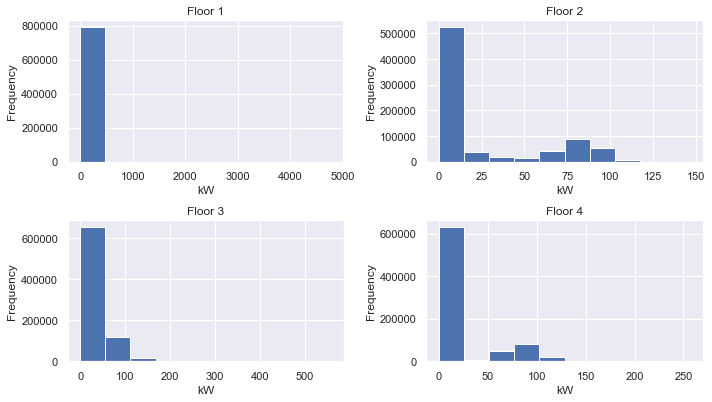

In [11]:
# Histograms for floors 1 - 4

fig = plt.figure(figsize = (10,8))
ax1 = fig.add_subplot(3, 2, 1)
ax2 = fig.add_subplot(3, 2, 2)
ax3 = fig.add_subplot(3, 2, 3)
ax4 = fig.add_subplot(3, 2, 4)

n, bins, patches = ax1.hist(df_power_floor['floor1'])
ax1.set_title('Floor 1')
ax1.set_xlabel('kW')
ax1.set_ylabel('Frequency')

n, bins, patches = ax2.hist(df_power_floor['floor2'])
ax2.set_title('Floor 2')
ax2.set_xlabel('kW')
ax2.set_ylabel('Frequency')

n, bins, patches = ax3.hist(df_power_floor['floor3'])
ax3.set_title('Floor 3')

ax3.set_xlabel('kW')
ax3.set_ylabel('Frequency')

n, bins, patches = ax4.hist(df_power_floor['floor4'])
ax4.set_title('Floor 4')
ax4.set_xlabel('kW')
ax4.set_ylabel('Frequency')

plt.tight_layout()


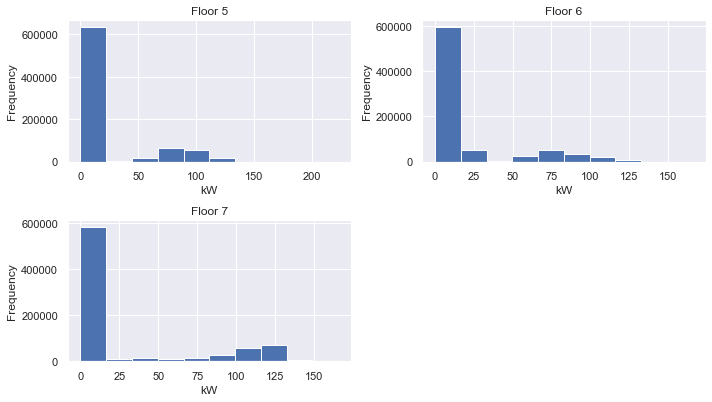

In [12]:
# Histograms for floors 5 - 7

fig = plt.figure(figsize = (10,8))
ax1 = fig.add_subplot(3, 2, 1)
ax2 = fig.add_subplot(3, 2, 2)
ax3 = fig.add_subplot(3, 2, 3)


n, bins, patches = ax1.hist(df_power_floor['floor5'])
ax1.set_title('Floor 5')
ax1.set_xlabel('kW')
ax1.set_ylabel('Frequency')

n, bins, patches = ax2.hist(df_power_floor['floor6'])
ax2.set_title('Floor 6')
ax2.set_xlabel('kW')
ax2.set_ylabel('Frequency')

n, bins, patches = ax3.hist(df_power_floor['floor7'])
ax3.set_title('Floor 7')

ax3.set_xlabel('kW')
ax3.set_ylabel('Frequency')

plt.tight_layout()

These histograms basically show us the distribution of power demand every minute. 

Now let's plot the time series data of the first month

In [13]:
# total power demand per minute
df_power_floor.iloc[:1440*30].iplot(yTitle='kW', title='Total Power Demand per Minute (30 days)')

There is no apparent trend in the data, however, there seems to be a seasonal effect. There's a drop in demand every 5 days, which represents weekdays and weekends. 

In the following cells i will implement hierarchical agglomerative clustering, meaning that i will take a Bottom-up approach to clustering on the hour-of-day and day-of-week profiles of each floor.

Hierarchical agglomerative clustering starts with treating each floor as it's own cluster, then using a similarity measure, it will cluster the two closest floor together. This continues until all the floors are in one cluster. 

In [14]:
from sklearn.preprocessing import MinMaxScaler
from scipy.cluster import hierarchy

dmap = {0:'Mon',1:'Tue',2:'Wed',3:'Thu',4:'Fri',5:'Sat',6:'Sun'}

# calculate the average day-of-week and hour-of-day profiles, then apply sklearn minmaxscaler
scaler = MinMaxScaler()

hour_of_day = df_power_floor.resample('H').sum().groupby(df_power_floor.resample('H').sum().index.hour).mean()
day_of_week = df_power_floor.resample('D').sum().groupby(df_power_floor.resample('D').sum().index.dayofweek).mean()
day_of_week.index = day_of_week.index.map(mapper=(lambda x: dmap[x]))


hour_of_day_norm = pd.DataFrame(scaler.fit_transform(hour_of_day.values),columns=hour_of_day.columns)
day_of_week_norm = pd.DataFrame(scaler.fit_transform(day_of_week.values),columns=day_of_week.columns)

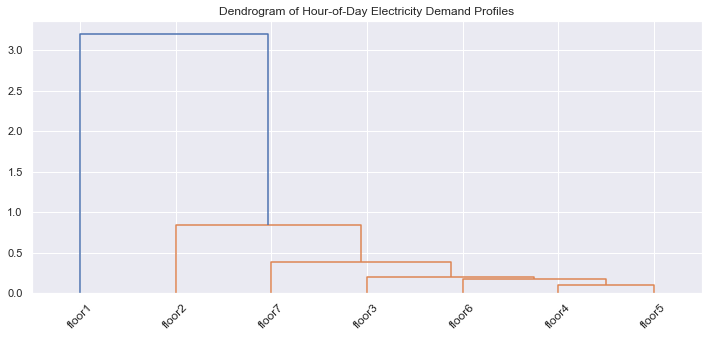

In [15]:
linked = hierarchy.linkage(hour_of_day_norm.values.T,'single')
labels = hour_of_day_norm.columns

plt.figure(figsize=(12, 5))
hierarchy.dendrogram(linked,orientation='top',labels=labels,distance_sort='descending',)
plt.xticks(rotation=45)
plt.title('Dendrogram of Hour-of-Day Electricity Demand Profiles')
plt.show()

The way we can interpret this dendrogram is by looking at the distances between the links. the shorter the distance, the more similar are the observations. 

In this case we can see that floor4 and floor5 were the first to be clustered together, meaning that their power demand is similar.However, it took more than have of the dendrogram for floor1 to be clustered with the rest of the floors, meaning that it is extremely different from them in terms of hourly power demand.

Sine we know that the building is a university building, it is most likely that the first floor are where the lecture halls, cafeterias, break rooms, etc. are, therefore the power demand is much more significant that the rest of the floors, which are more likely to be offices for the staff. 

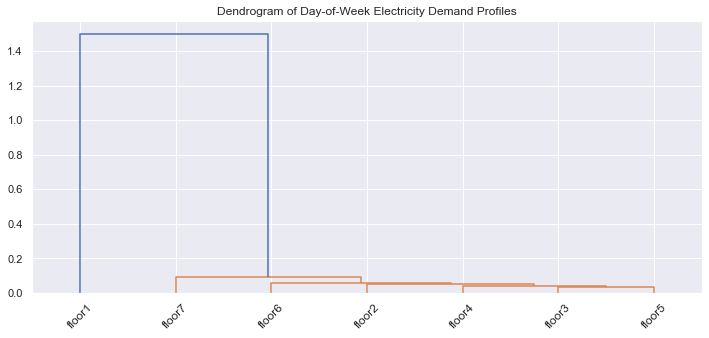

In [16]:
linked = hierarchy.linkage(day_of_week_norm.values.T,'single')
labels = day_of_week_norm.columns

plt.figure(figsize=(12,5))
hierarchy.dendrogram(linked,orientation='top',labels=labels,distance_sort='descending')
plt.xticks(rotation=45)
plt.title('Dendrogram of Day-of-Week Electricity Demand Profiles')
plt.show()

In [17]:
hour_of_day.iplot(title= 'Average Hourly Power Demand per Floor', yTitle='Mean Power Demand [kW]')

In [18]:
day_of_week.iplot(title= 'Average Daily Power Demand', yTitle='Mean Power Demand [kW]')

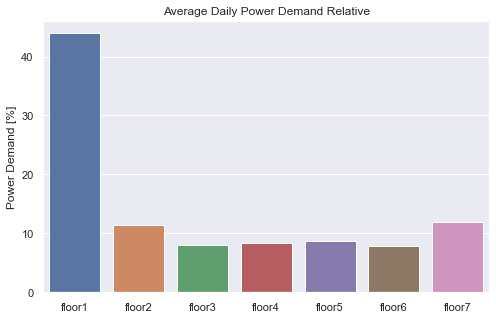

In [19]:
hour_of_day_precent = pd.DataFrame(hour_of_day.sum())
total = hour_of_day_precent.sum()[0]
hour_of_day_precent['%'] = hour_of_day_precent[0].apply(lambda x: (x/total)*100)

y = hour_of_day_precent['%']
x = hour_of_day_precent.index
plt.figure(figsize=(8,5))
sns.barplot(x=x, y=y)
plt.ylabel('Power Demand [%]')
plt.xlabel('')
plt.title('Average Daily Power Demand Relative');


This plot shows that over 40% of the daily power demand of the entire building comes from floor 1

## 1) Power Demand per Appliance

In [20]:
df_power_appliance.head()

,ACs,Lights,Plugs
Date,,,
2018-07-01 00:00:00,61.53,74.08,40.70
2018-07-01 00:01:00,61.57,74.16,40.31
2018-07-01 00:02:00,60.15,74.12,40.27
2018-07-01 00:03:00,61.54,74.30,39.88
2018-07-01 00:04:00,61.54,74.39,38.97


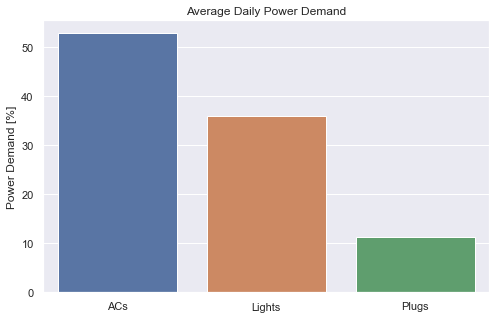

In [21]:
# precentage of power demand per day per appliance
df_appliance_daily = df_power_appliance.resample('D').sum()
df_appliance_total = df_appliance_daily.mean()

df_appliance_precent = pd.DataFrame(df_appliance_total)
total = df_appliance_total.sum()
df_appliance_precent['%'] = df_appliance_precent[0].apply(lambda x: (x/total)*100)
df_appliance_precent


y = df_appliance_precent['%']
x = df_appliance_precent.index
plt.figure(figsize=(8,5))
sns.barplot(x=x, y=y)
plt.ylabel('Power Demand [%]')
plt.xlabel('')
plt.title('Average Daily Power Demand');

##  Cost of Electricity 
In this section I will transform the kW data into kWh data so that it can be more understandable. Then i will calculate the monthly and yearly electricity costs of the building based on current electricity prices in different countries.

**A kilowatt (kW)**: is a measure of power, or the rate something uses energy.

**A kilowatt-hour (kWh)**: is the amount of energy consumed in one hour by a device pulling one kilowatt of power.

Therefore, in the case of this dataset, the energy used by the building in kWh over 30 days is can be calculated by multiplying the power draw in kW by the time interval between measurements in hours.

kWh (30 days) = 1 minute/60 * (SUM of kW over 30 days)

In [22]:
# transform to mothly kWh data
df_power_floor.head()

floor,floor1,floor2,floor3,floor4,floor5,floor6,floor7
Date,,,,,,,
2018-07-01 00:00:00,155.73,8.04,0.44,9.74,1.07,0.82,0.47
2018-07-01 00:01:00,155.44,8.02,0.56,9.74,1.06,0.81,0.41
2018-07-01 00:02:00,155.34,6.73,0.50,9.61,0.98,0.86,0.52
2018-07-01 00:03:00,154.92,7.94,0.44,9.83,1.05,0.92,0.62
2018-07-01 00:04:00,154.07,7.89,0.56,9.88,1.01,0.91,0.58


In [23]:
def kw_to_kwh(data,interval_minutes = 1):
    for column in data.columns:
        data[column+'_kWh'] = data[column].apply(lambda x: round((interval_minutes/60)*x, 2))
        data.drop(column, axis = 1, inplace = True)
    return data

In [24]:
df_power_daily = df_power_floor.resample('D').sum()
df_power_weekly = df_power_floor.resample('W').sum()
df_power_monthly = df_power_floor.resample('M').sum()
df_power_yearly = df_power_floor.resample('Y').sum()

df_power_daily_kwh = kw_to_kwh(df_power_daily)
df_power_weekly_kwh = kw_to_kwh(df_power_weekly)
df_power_monthly_kwh = kw_to_kwh(df_power_monthly)
df_power_yearly_kwh = kw_to_kwh(df_power_yearly)

In [59]:
def build_comparison_graph(data, title):

    fig = go.Figure(layout=go.Layout(title= go.layout.Title(text=title)))
    fig.update_layout(title_x=0.5, title_y=0.98)

    fig.add_trace(go.Bar(name= 'Selection 1',
                         x= data.index,
                         y= data['floor1_kWh'].values, marker_color='#1a508b'))

    buttons = []
    for i in df_power_monthly_kwh.columns:
        buttons.append(dict(method='restyle',
                            label= i[:6],
                            visible=True,
                            args=[{'y':[data[i].values],
                                   'x':[data.index],
                                   'type':'bar'}, [0]],
                            )
                      )

    fig.add_trace(go.Bar(name= 'Selection 1',
                         x= data.index,
                         y= data['floor1_kWh'].values, marker_color='#ffc764'))

    buttons2 = []
    for i in data.columns:
        buttons2.append(dict(method='restyle',
                            label= i[:6],
                            visible=True,
                            args=[{'y':[data[i].values],
                                   'x':[data.index],
                                   'type':'bar'}, [1]],
                            )
                      )

    button_layer_1_height = 1.23
    updatemenus = list([
        dict(buttons=buttons,
                direction="down",
                pad={"r": 10, "t": 20},
                showactive=True,
                x=0.11,
                xanchor="left",
                y=button_layer_1_height,
                yanchor="top"),

        dict(buttons=buttons2,
                direction="down",
                pad={"r": 2, "t": 20},
                showactive=True,
                x=0.36,
                xanchor="left",
                y=button_layer_1_height,
                yanchor="top")])

    fig.update_layout(
        annotations=[
            dict(text="Selection 1", x=0, xref="paper", y=1.15, yref="paper",
                                 align="left", showarrow=False),
            dict(text="Selection 2", x=0.25, xref="paper", y=1.15,
                                 yref="paper", showarrow=False)
        ])

    fig.update_layout(updatemenus=updatemenus)
    fig.update_yaxes(title = 'kWh')
    fig.show()

In [60]:
build_comparison_graph(df_power_monthly_kwh, 'Comparing Floors by Monthly Energy Consumption')

According to an Eu buildings factsheet on
Energy use in buildings published by the European Commission, Non-residential buildings use on average between 200 and 300 kWh per m² per year. 

Given that the building is approx. 11,700 m², the average yearly kWh should be between 2,340,000 and 3,510,000 kWh 

https://ec.europa.eu/energy/eu-buildings-factsheets-topics-tree/energy-use-buildings_en

In [27]:
df_power_yearly_kwh.sum(axis=1)

Date
2018-12-31    1090310.13
2019-12-31    2092293.61
Freq: A-DEC, dtype: float64

We can see that it's within the range that we calculated 

# Power Demand of Entire Building

## Average electricity costs:

- Thailand (Data source): 0.104 €/kWh
- Germany: 0.193 €/kWh
- UK: 0.196 €/kWh
- USA: 0.092 €/kWh

Source - https://www.globalpetrolprices.com/Philippines/electricity_prices/


In [28]:
def kWh_cost(x, country):
    cost_dict = {'THAILAND': 0.104, 'GERMANY': 0.193, 'UK': 0.196, 'USA': 0.092}
    return round(cost_dict[country.upper()]*x, 2)

In [29]:
country_list = ['THAILAND','GERMANY', 'UK', 'USA']

df_cost_monthly = df_power_monthly_kwh.copy()
df_cost_monthly = pd.DataFrame(df_cost_monthly.sum(axis = 1))
df_cost_monthly.columns = ['kWh']

df_cost_yearly = df_power_yearly_kwh.copy()
df_cost_yearly = pd.DataFrame(df_cost_yearly.sum(axis = 1))
df_cost_yearly.columns = ['kWh']

for name in country_list:
    df_cost_monthly[name +' [€]'] = df_cost_monthly['kWh'].apply(lambda x: kWh_cost(x,name ))
    df_cost_yearly[name +' [€]'] = df_cost_yearly['kWh'].apply(lambda x: kWh_cost(x,name ))

In [30]:
df_avg_cost_monthly = df_cost_monthly.mean()
df_avg_cost_yearly = df_cost_yearly.mean()

df_avg_cost = pd.concat([df_avg_cost_monthly, df_avg_cost_yearly], axis = 1)
df_avg_cost = df_avg_cost.iloc[1:, ::]
df_avg_cost.columns = ['Monthly', 'Yearly']
df_avg_cost.index = ['Thailand', 'Germany', 'UK', 'US']
df_avg_cost

,Monthly,Yearly
Thailand,18388.377778,165495.395
Germany,34124.585556,307121.265
UK,34655.018889,311895.170
US,16266.641111,146399.770


In [31]:
fig = go.Figure(layout=go.Layout(title= go.layout.Title(text='Average Building Electricity Costs')))
fig.update_layout(title_x=0.5, title_y=0.98)

fig.add_trace(go.Bar(name= 'Selection',
                     x= df_avg_cost.index,
                     y= df_avg_cost['Monthly'].values, marker_color=['orange', 'crimson', 'red', 'lightgreen']))


buttons = []
for i in df_avg_cost.columns:
    buttons.append(dict(method='restyle',
                        label= i,
                        visible=True,
                        args=[{'y':[df_avg_cost[i].values],
                               'x':[df_avg_cost.index],
                               'type':'bar'}, [0]],
                        )
                  )

button_layer_1_height = 1.23
updatemenus = list([
    dict(buttons=buttons,
            direction="down",
            pad={"r": 10, "t": 20},
            showactive=True,
            x=0.11,
            xanchor="left",
            y=button_layer_1_height,
            yanchor="top")])


fig.update_layout(updatemenus=updatemenus)
fig.update_yaxes(title = 'Cost [€]')

fig.show()

We can see that 

In [32]:
#df_power_daily.to_csv('Data/df_power_daily.csv')